In [8]:
import numpy as np
import pandas as pd
import plotly.express as px
import plotly as py
import plotly.graph_objects as go
import ipywidgets as widgets
import datetime as dt
import seaborn as sns
import matplotlib.pyplot as plt

#to keep plotly offline
py.offline.init_notebook_mode(connected=True)

In [9]:
#import files 
"""
lien vers data.gouv :
https://www.data.gouv.fr/fr/datasets/trajets-realises-en-covoiturage-registre-de-preuve-de-covoiturage/
"""

import os
path =  '/Users/vincentgargasson/Downloads/'

#import insee studies number of people in 2017 per cities in France

df_hab = pd.read_csv(path + '/ensemble/Communes.csv',sep=";")


#import french train station location file

df_gare = pd.read_csv(path + 'liste-des-gares.csv',sep=";")


li = []
for file in os.listdir(path):
    if file.endswith("-vf.csv"):
        print(os.path.join(path, file))
        df = pd.read_csv(os.path.join(path, file),sep=";")
        li.append(df)
        
df = pd.concat(li)

/Users/vincentgargasson/Downloads/2019-11-vf.csv
/Users/vincentgargasson/Downloads/2019-12-vf.csv
/Users/vincentgargasson/Downloads/2020-01-vf.csv
/Users/vincentgargasson/Downloads/2020-02-vf.csv
/Users/vincentgargasson/Downloads/2020-03-vf.csv
/Users/vincentgargasson/Downloads/2020-04-vf.csv
/Users/vincentgargasson/Downloads/2020-05-vf.csv
/Users/vincentgargasson/Downloads/2020-06-vf.csv


In [10]:
#first views

print("Il y a {} lignes et {} colonnes".format(df.shape[0],df.shape[1]))
df.head()

Il y a 2021202 lignes et 16 colonnes


,trip_id,journey_start_datetime,journey_start_lat,journey_start_lon,journey_start_insee,journey_start_postcode,journey_start_town,journey_start_country,journey_end_datetime,journey_end_lat,journey_end_lon,journey_end_insee,journey_end_postcode,journey_end_town,journey_end_country,journey_id
0,6e1da7fb-1f3e-44c1-876b-7dac518a5b35,2019-11-01T00:00:00.000Z,48.830,2.493,94017,94500,Champigny-sur-Marne,France,2019-11-01T00:30:00.000Z,48.724,2.262,91377,91300,Massy,France,NaN
1,18ec6db1-bd8e-446f-a303-7ceea81e3c8e,2019-11-01T00:00:00.000Z,48.870,2.224,92073,92150,Suresnes,France,2019-11-01T00:45:00.000Z,48.811,2.378,94041,94200,Ivry-sur-Seine,France,NaN
2,8200a83b-3008-41b5-9b74-74f8836dff5e,2019-11-01T00:00:00.000Z,48.620,2.560,77251,77127,Lieusaint,France,2019-11-01T00:15:00.000Z,48.606,2.505,91573,91280,Saint-Pierre-du-Perray,France,NaN
3,ac0208d4-8748-4cce-831a-379c667d352f,2019-11-01T00:00:00.000Z,48.854,2.384,75056,75001,Paris,France,2019-11-01T00:30:00.000Z,48.790,2.369,94076,94800,Villejuif,France,NaN
4,ba98aa22-5de4-4d88-bab0-31f1eabf0ec7,2019-11-01T00:00:00.000Z,48.839,2.654,77468,77200,Torcy,France,2019-11-01T00:00:00.000Z,48.848,2.647,77468,77200,Torcy,France,NaN


In [11]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2021202 entries, 0 to 128945
Data columns (total 16 columns):
 #   Column                  Dtype  
---  ------                  -----  
 0   trip_id                 object 
 1   journey_start_datetime  object 
 2   journey_start_lat       float64
 3   journey_start_lon       float64
 4   journey_start_insee     int64  
 5   journey_start_postcode  int64  
 6   journey_start_town      object 
 7   journey_start_country   object 
 8   journey_end_datetime    object 
 9   journey_end_lat         float64
 10  journey_end_lon         float64
 11  journey_end_insee       int64  
 12  journey_end_postcode    int64  
 13  journey_end_town        object 
 14  journey_end_country     object 
 15  journey_id              float64
dtypes: float64(5), int64(4), object(7)
memory usage: 262.1+ MB


In [12]:
df.isnull().sum()

trip_id                    232921
journey_start_datetime          0
journey_start_lat               0
journey_start_lon               0
journey_start_insee             0
journey_start_postcode          0
journey_start_town              0
journey_start_country           0
journey_end_datetime            0
journey_end_lat                 0
journey_end_lon                 0
journey_end_insee               0
journey_end_postcode            0
journey_end_town                0
journey_end_country             0
journey_id                1788281
dtype: int64

In [13]:
df.describe(include="all")

,trip_id,journey_start_datetime,journey_start_lat,journey_start_lon,journey_start_insee,journey_start_postcode,journey_start_town,journey_start_country,journey_end_datetime,journey_end_lat,journey_end_lon,journey_end_insee,journey_end_postcode,journey_end_town,journey_end_country,journey_id
count,1788281,2021202,2.021202e+06,2.021202e+06,2.021202e+06,2.021202e+06,2021202,2021202,2021202,2.021202e+06,2.021202e+06,2.021202e+06,2.021202e+06,2021202,2021202,2.329210e+05
unique,1532986,22258,NaN,NaN,NaN,NaN,3878,1,22291,NaN,NaN,NaN,NaN,3762,1,NaN
top,e5fee430-f6d3-4f6a-8a9f-3b58a3a11391,2019-12-16T07:00:00.000Z,NaN,NaN,NaN,NaN,Paris,France,2019-12-17T07:15:00.000Z,NaN,NaN,NaN,NaN,Paris,France,NaN
freq,42,1822,NaN,NaN,NaN,NaN,133654,2021202,1789,NaN,NaN,NaN,NaN,131770,2021202,NaN
mean,NaN,NaN,4.797099e+01,2.460994e+00,7.419234e+04,7.427615e+04,NaN,NaN,NaN,4.797162e+01,2.460691e+00,7.420149e+04,7.428367e+04,NaN,NaN,3.380726e+06
std,NaN,NaN,1.865637e+00,1.674709e+00,2.376859e+04,2.377563e+04,NaN,NaN,NaN,1.864768e+00,1.674681e+00,2.375708e+04,2.376179e+04,NaN,NaN,7.185708e+04
min,NaN,NaN,-2.133000e+01,-4.670000e+00,1.004000e+03,1.000000e+03,NaN,NaN,NaN,-2.134000e+01,-4.680000e+00,1.004000e+03,1.000000e+03,NaN,NaN,3.255144e+06
25%,NaN,NaN,4.843000e+01,2.150000e+00,6.929000e+04,6.976000e+04,NaN,NaN,NaN,4.843000e+01,2.150000e+00,6.929000e+04,6.976000e+04,NaN,NaN,3.317724e+06
50%,NaN,NaN,4.878300e+01,2.318000e+00,7.854500e+04,7.835000e+04,NaN,NaN,NaN,4.878300e+01,2.317000e+00,7.854500e+04,7.833000e+04,NaN,NaN,3.381047e+06
75%,NaN,NaN,4.887400e+01,2.527000e+00,9.204000e+04,9.224000e+04,NaN,NaN,NaN,4.887300e+01,2.527000e+00,9.204000e+04,9.223000e+04,NaN,NaN,3.442417e+06


In [14]:
# A preview of Insee file 
df_hab.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 34995 entries, 0 to 34994
Data columns (total 5 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   DEPCOM  34995 non-null  object
 1   COM     34995 non-null  object
 2   PMUN    34995 non-null  int64 
 3   PCAP    34995 non-null  int64 
 4   PTOT    34995 non-null  int64 
dtypes: int64(3), object(2)
memory usage: 1.3+ MB


In [15]:
df_hab.head()

,DEPCOM,COM,PMUN,PCAP,PTOT
0,01001,L' Abergement-Clémenciat,776,18,794
1,01002,L' Abergement-de-Varey,248,1,249
2,01004,Ambérieu-en-Bugey,14035,393,14428
3,01005,Ambérieux-en-Dombes,1689,34,1723
4,01006,Ambléon,111,6,117


In [16]:
df_gare.head()

,CODE_UIC,LIBELLE,FRET,VOYAGEURS,CODE_LIGNE,RG_TRONCON,PK,COMMUNE,DEPARTEMEN,IDRESEAU,IDGAIA,X_L93,Y_L93,X_WGS84,Y_WGS84,C_GEO,Geo Point,Geo Shape
0,87697300,Épinay-Villetaneuse TT,N,O,960000,1,046+970,MONTMAGNY,SEINE-SAINT-DENIS,171221,35208e16-0d53-11e6-8dff-016064e0362d,650838.8503,6.873439e+06,2.328662,48.959027,"48.95902745317701,2.328662032747888","48.9590274532,2.32866203275","{""type"": ""Point"", ""coordinates"": [2.3286620327..."
1,87611707,Escalquens,O,O,640000,1,269+464,ESCALQUENS,HAUTE-GARONNE,4073,c08e2002-f312-11e3-90ff-015864e0362d,582123.1645,6.269700e+06,1.542606,43.516592,"43.51659153044671,1.5426060880164587","43.5165915304,1.54260608802","{""type"": ""Point"", ""coordinates"": [1.5426060880..."
2,87764472,Le Teil,O,O,800000,1,665+633,LE TEIL,ARDECHE,5010,d9c28f04-6667-11e3-89ff-01f464e0362d,833949.7857,6.385159e+06,4.686544,44.552630,"44.55262971161194,4.686544297614275","44.5526297116,4.68654429761","{""type"": ""Point"", ""coordinates"": [4.6865442976..."
3,87444208,Mézidon,O,O,430000,1,142+485,MÉZIDON-CANON,CALVADOS,5504,293fc75e-dfbc-11e3-a2ff-01a464e0362d,475400.6140,6.890021e+06,-0.074439,49.070687,"49.07068696758813,-0.07443918382927721","49.0706869676,-0.0744391838293","{""type"": ""Point"", ""coordinates"": [-0.074439183..."
4,87192302,Bénestroff,N,O,100000,2,034+534,BÉNESTROFF,MOSELLE,3180,294dd0ac-dfbc-11e3-a2ff-01a464e0362d,974830.1574,6.873882e+06,6.750598,48.906184,"48.90618393340398,6.750598020177406","48.9061839334,6.75059802018","{""type"": ""Point"", ""coordinates"": [6.7505980201..."


In [17]:
#More info here : https://ressources.data.sncf.com/explore/dataset/liste-des-gares/information/?location=8,48.70263,3.11462&basemap=jawg.transports
df_gare.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4148 entries, 0 to 4147
Data columns (total 18 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   CODE_UIC    4148 non-null   int64  
 1   LIBELLE     4148 non-null   object 
 2   FRET        4148 non-null   object 
 3   VOYAGEURS   4148 non-null   object 
 4   CODE_LIGNE  4148 non-null   int64  
 5   RG_TRONCON  4148 non-null   int64  
 6   PK          4148 non-null   object 
 7   COMMUNE     4148 non-null   object 
 8   DEPARTEMEN  4148 non-null   object 
 9   IDRESEAU    4148 non-null   int64  
 10  IDGAIA      4148 non-null   object 
 11  X_L93       4148 non-null   float64
 12  Y_L93       4148 non-null   float64
 13  X_WGS84     4148 non-null   float64
 14  Y_WGS84     4148 non-null   float64
 15  C_GEO       4148 non-null   object 
 16  Geo Point   4148 non-null   object 
 17  Geo Shape   4148 non-null   object 
dtypes: float64(4), int64(4), object(10)
memory usage: 583.4+ KB


### What relevant business question could we ask ourself by taking a look at this dataset?

##### A. What are the main drivers that take the carsharing trend to normal state? Train pricing? 
##### B. What are the forecast for the next months? Weeks?
##### C. What are the cities that need the more Blablacar since the end of confinement? Start? End?


### 1. PREPROCESSING & VISUALISATION

In [18]:
#Date format

col_time = df[['journey_start_datetime','journey_end_datetime']]
for i in col_time:
    df[i] = pd.to_datetime(df[i])

#adding trip duration feature
df['trip_length'] = df['journey_end_datetime'] - df['journey_start_datetime']

sub_df = df.sample(500000)
sub_df['count'] = 1
sub_df.head()

,trip_id,journey_start_datetime,journey_start_lat,journey_start_lon,journey_start_insee,journey_start_postcode,journey_start_town,journey_start_country,journey_end_datetime,journey_end_lat,journey_end_lon,journey_end_insee,journey_end_postcode,journey_end_town,journey_end_country,journey_id,trip_length,count
6258,NaN,2020-06-02 18:15:00+00:00,48.779,2.461,94028,94000,CrÃ©teil,France,2020-06-02 18:30:00+00:00,48.813,2.371,94041,94200,Ivry-sur-Seine,France,3369911.0,00:15:00,1
73773,41400bd6-985a-48ed-b0bf-9215dd0e866b,2019-11-20 05:15:00+00:00,48.610,2.250,91339,91310,Linas,France,2019-11-20 05:45:00+00:00,48.778,2.239,92060,92350,Le Plessis-Robinson,France,NaN,00:30:00,1
283604,db60365d-7a72-4211-a05b-c18999b6fb13,2019-12-11 17:15:00+00:00,44.940,-0.230,33243,33500,Libourne,France,2019-12-11 18:00:00+00:00,44.840,-0.553,33063,33000,Bordeaux,France,NaN,00:45:00,1
137017,db41e166-1b61-4cae-9d86-21e0454c68f4,2020-03-10 08:15:00+00:00,48.879,2.305,75108,75008,Paris 8Ã¨me,France,2020-03-10 08:30:00+00:00,48.869,2.295,75116,75016,Paris 16Ã¨me,France,NaN,00:15:00,1
339327,edb99cc4-71f0-46b8-9bd4-7a939e5ab6fe,2019-12-09 15:00:00+00:00,48.587,2.246,91021,91290,Arpajon,France,2019-12-09 15:15:00+00:00,48.560,2.260,91292,91630,Guibeville,France,NaN,00:15:00,1


<AxesSubplot:xlabel='trip_length_min'>

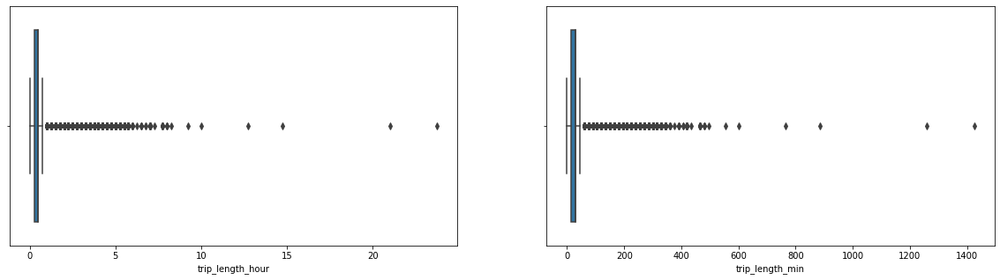

In [19]:
#distribution of trip length 

sub_df['trip_length_sec'] = [i.total_seconds() for i in sub_df.trip_length]
sub_df['trip_length_min'] = sub_df['trip_length_sec']/60
sub_df['trip_length_hour'] = sub_df['trip_length_sec']/3600
sub_df['start_day'] = sub_df['journey_start_datetime'].dt.dayofweek
sub_df.replace({'start_day': {0: 'Monday',
                              1: 'Tuesday',
                              2: 'Wednesday',
                              3: 'Thursday',
                              4: 'Friday',
                              5: 'Saturday',
                              6: 'Sunday'}},inplace=True)


fig, ax = plt.subplots(nrows=1, ncols=2,figsize=(20,5))
sns.boxplot(sub_df.trip_length_hour, ax= ax[0])
sns.boxplot(sub_df.trip_length_min, ax= ax[1])

In [20]:
#distribution of trip 

df_time = sub_df.copy()
df_time.set_index('journey_start_datetime',inplace=True)
grouped = df_time.groupby(by='journey_start_datetime')['count'].sum()
grouped = pd.DataFrame(grouped.resample('D').sum())

#add column with day of week
grouped['dayofweek'] = grouped.index
grouped['dayofweek'] = grouped['dayofweek'].dt.dayofweek
grouped.replace(
                                    {'dayofweek': {0: 'Monday',
                                                   1: 'Tuesday',
                                                   2: 'Wednesday',
                                                   3: 'Thursday',
                                                   4: 'Friday',
                                                   5: 'Saturday',
                                                   6: 'Sunday'}},inplace=True)

fig = px.line(grouped, x=grouped.index, y='count',color='dayofweek')
fig.show()

In [21]:
#See the correlation between number of people in a city and the number of trip
import re

#1st Removal of the INSEE city number with letter in order to be able to turn them into Int format

print('Before removing the string value in the DEPCOM column, we had {} lines'.format(len(df_hab)))

df_hab['numerical_DEPCOM'] = [re.search("[A-Z]", i) for i in df_hab['DEPCOM']]
df_hab_filtered = df_hab[[i is None for i in df_hab['numerical_DEPCOM']]]
df_hab_filtered['DEPCOM'] = df_hab_filtered['DEPCOM'].astype('str').astype('int')

print('After removing the string value in the DEPCOM column, we have {} lines'.format(len(df_hab_filtered)))

Before removing the string value in the DEPCOM column, we had 34995 lines
After removing the string value in the DEPCOM column, we have 34635 lines


/Applications/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [22]:
#2 Creation of Aggregated dataframe with Count of trip per city (in and out)

def df_agg_trip(insee_num,town,lat):
    df = pd.DataFrame(sub_df[[insee_num,town,lat]]\
                 .groupby([insee_num,town]).agg(['count']))\
                 .sort_values(by=(lat,'count'),ascending=False)\
                 .reset_index()
                 
    df = pd.merge(df,df_hab_filtered[['DEPCOM','PTOT']]
                           ,how='inner'
                           ,left_on=insee_num
                           ,right_on='DEPCOM').drop('DEPCOM', axis=1)   
    
    df.rename(columns={df.columns[0]: insee_num,
                       df.columns[1]: town,
                       df.columns[2]: "Trip_vol"}, inplace = True)
    return df

df_agg_trip_in = df_agg_trip('journey_start_insee','journey_start_town','journey_start_lat') 
df_agg_trip_out = df_agg_trip('journey_end_insee','journey_end_town','journey_end_lat') 

df_agg_trip_in.head()

/Applications/anaconda3/lib/python3.7/site-packages/pandas/core/reshape/merge.py:618: UserWarning:

merging between different levels can give an unintended result (2 levels on the left, 1 on the right)



,journey_start_insee,journey_start_town,Trip_vol,PTOT
0,31555,Toulouse,10415,484809
1,91377,Massy,7085,51142
2,78297,Guyancourt,7064,29065
3,92012,Boulogne-Billancourt,5362,121249
4,94028,CrÃ©teil,5095,91120


In [23]:
#let's normalize the target trip_vol and PTOT to compare them on the same scale
from sklearn import preprocessing

def normalization(df,col1,col2):
    df[col1+'_normalized'] = (df[col1] - df[col1].mean())/df[col1].std()
    df[col2+'_normalized'] = (df[col2] - df[col2].mean())/df[col2].std()
    return df

df_agg_trip_in = normalization(df_agg_trip_in,'Trip_vol','PTOT')
df_agg_trip_out = normalization(df_agg_trip_out,'Trip_vol','PTOT')

df_agg_trip_out.describe()

,journey_end_insee,Trip_vol,PTOT,Trip_vol_normalized,PTOT_normalized
count,3684.000000,3684.000000,3684.000000,3.684000e+03,3.684000e+03
mean,55041.205483,125.875407,11323.248371,-1.878308e-15,-6.419494e-16
std,26396.534326,473.524621,24354.748585,1.000000e+00,1.000000e+00
min,1004.000000,1.000000,74.000000,-2.637147e-01,-4.618914e-01
25%,33229.750000,5.000000,1897.750000,-2.552674e-01,-3.870087e-01
50%,59159.000000,14.000000,4509.000000,-2.362610e-01,-2.797914e-01
75%,77373.250000,53.000000,10260.000000,-1.538999e-01,-4.365672e-02
max,97416.000000,10226.000000,484809.000000,2.132967e+01,1.944121e+01


In [24]:
#plot trend curve of both PTOT and trip vol for incoming and outcoming trip per city

from plotly.subplots import make_subplots

df_trip_in_reduced = df_agg_trip_in[df_agg_trip_in['Trip_vol']>50]
df_trip_out_reduced = df_agg_trip_out[df_agg_trip_out['Trip_vol']>50]

fig = make_subplots(rows=2, cols=1,subplot_titles=("Trip Volume and Population for incoming trip",
                                                   "Trip Volume and Population for outcoming trip"))

fig.add_trace(go.Scatter(x=df_trip_in_reduced.journey_start_town,
                         y=df_trip_in_reduced.Trip_vol_normalized,
                         mode='lines',
                         name='Trip Volume'),
              row=1,col=1)
fig.add_trace(go.Scatter(x=df_trip_in_reduced.journey_start_town,
                         y=df_trip_in_reduced.PTOT_normalized,
                         mode='lines',
                         name='Population'),
              row=1,col=1)


fig.add_trace(go.Scatter(x=df_trip_out_reduced.journey_end_town,
                         y=df_trip_out_reduced.Trip_vol_normalized,
                         mode='lines',
                         name='Trip Volume'),
              row=2,col=1)
fig.add_trace(go.Scatter(x=df_trip_out_reduced.journey_end_town,
                         y=df_trip_out_reduced.PTOT_normalized,
                         mode='lines',
                         name='Population'),
              row=2,col=1)


fig.update_layout(height=1200, width=900, title_text="Trip volume and population of incoming and trip")
fig.show()

In [25]:
#

In [26]:
#more sophisticated graph

fig = go.Figure()

# You can add multiple traces, in this case financial securities
fig.add_trace(go.Scatter(x=grouped.index, y=grouped['count'],
                         name="Campbell Soup Company", line_color='deepskyblue'))



# Add title and annotations
fig.update_layout(title_text='Carsharing sample from nov 2019 to june 2020',
                  title={
                    'y':0.9,
                    'x':0.5,
                    'xanchor': 'center',
                    'yanchor': 'top'},
                  xaxis_rangeslider_visible=True, xaxis_title="Time", yaxis_title="Trip volume")

fig.update_xaxes(
    rangeslider_visible=True,
    rangeselector=dict(
        buttons=list([
            dict(count=1, label="1m", step="month", stepmode="backward"),
            dict(count=6, label="6m", step="month", stepmode="backward"),
            dict(count=1, label="YTD", step="year", stepmode="todate"),
            dict(count=1, label="1y", step="year", stepmode="backward"),
            dict(step="all")
        ])
    )
)



fig.show()

In [27]:
fig = px.box(sub_df,x='start_day', y="trip_length_hour")
fig.show()

#### Investigation of the proximity of town with a train station

In [34]:
# 1 Calculate closest train station from each trip coordinate 
# Use simple algorithme that does the following: 
    #1. create matrix of distance between each train station 
    #2. create loop that calculate the distance between the origin point and a random train station
    #3. Adjust the list of following train station on which we have to calculate the distance according 
    #the distance matrix (We only keep the train station less that twice the distance previously calculated away
    #from the train station previoulsy used)
    #4. At the end of the loop, we take the smalled distance in the list

from geopy import distance

start_lat = sub_df['journey_start_lat']
start_lon = sub_df['journey_start_lon']
start_coordinate = list(zip(start_lat,start_lon))

def get_closest_point(coord_origin, coord_destination):
    l = []
    for i in coord_origin:
        d = []
        for j in coord_destination:
            distance = distance.distance(i,j).km
            d.append(distance)
            
    

In [ ]:
"""
Produce gare_distance_matrix

from geopy import distance
import time 
import sys 

lat_gare = df_gare['Y_WGS84']
lon_gare = df_gare['X_WGS84']
gare_coord = list(zip(lat_gare,lon_gare))
gare_coord = tuple(map(tuple, np.array(gare_coord)))


gare_distance_matrix = pd.DataFrame(index=df_gare['CODE_UIC'])
l = []
n = -1

start_time = time.time()
for i in gare_coord:
    if n >= 0:
        UIC = df_gare['CODE_UIC'][n]
        gare_distance_matrix[UIC] = l
        l = []
        end_time = time.time()
        print('{}eme loop : {}'.format(n,end_time-start_time))
        
    for j in gare_coord:
        d = distance.distance(i, j).km
        l.append(d)
    n = n+1

gare_distance_matrix.to_csv('gare_distance_matrix.csv',index=True)
"""

In [152]:
gare_distance_matrix.head()

,87697300,87611707,87764472
CODE_UIC,,,
87697300,0.000000,607.979835,521.847611
87611707,607.979835,0.000000,277.038064
87764472,521.847611,277.038064,0.000000
87444208,176.217504,629.782324,619.646098
87192302,324.004837,721.004597,508.980372


In [159]:
gare_distance_matrix.to_csv('gare_distance_matrix.csv',index=True)

In [164]:
pd.read_csv('gare_distance_matrix.csv',index_col=['CODE_UIC'])

,87697300,87611707,87764472
CODE_UIC,,,
87697300,0.000000,607.979835,521.847611
87611707,607.979835,0.000000,277.038064
87764472,521.847611,277.038064,0.000000
87444208,176.217504,629.782324,619.646098
87192302,324.004837,721.004597,508.980372
...,...,...,...
87713578,289.729029,455.086630,263.808301
87581876,490.968817,235.001390,417.308387
87174821,162.896055,664.215833,507.868224


In [106]:
type(gare_coord[0])

tuple

In [107]:
type((41.49008, -71.312796))

tuple

In [130]:
(400*15)

6000

In [131]:
6000/3600

1.6666666666666667